<a href="https://colab.research.google.com/github/ChebetPlastic/Cardiac_risk_app/blob/main/cardiac_risk_app.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import openpyxl
from google.colab import files
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sp
import joblib
print("📂 Please upload your Excel file (e.g., your_original_file.xlsx)")
uploaded = files.upload()

# Get uploaded filename
filename = list(uploaded.keys())[0]
#DATA LOADING AND PREPARATION

📂 Please upload your Excel file (e.g., your_original_file.xlsx)


Saving cardiac_risk_app.xlsx to cardiac_risk_app (1).xlsx


In [ ]:
df=pd.read_excel('/content/cardiac_risk_app.xlsx', engine='openpyxl')

CALCULATING THE RISK SCORE OF EACH PARAMETER OF DATA
CALCULATE THE RISK SCORE FOR ONE ROW OF DATA.

In [ ]:
def calculate_risk(row):
  results =  results = {'SPO2': {'value': row['SPO2'], 'score': 0, 'risk': 'Normal', 'highlight': ''},
               'HR': {'value': row['HR'], 'score': 0, 'risk': 'Normal', 'highlight': ''},
               'BMI': {'value': row['BMI'], 'score': 0, 'risk': 'Normal', 'highlight': ''},
               'ECG': {'value': row['ECG'], 'score': 0, 'risk': 'Normal', 'highlight': ''}}



MODEL CREATION

Calculate_risk. This is the core of the code.
Rule based scoring: Hard coded clinical rules.

In [ ]:
def calculate_risk(row):
    results = {'SPO2': {'value': row['SPO2'], 'score': 0, 'risk': 'Normal', 'highlight': ''},
               'HR': {'value': row['HR'], 'score': 0, 'risk': 'Normal', 'highlight': ''},
               'ECG': {'value': row['ECG'], 'score': 0, 'risk': 'Normal', 'highlight': ''},
               'BMI': {'value': row['BMI'], 'score': 0, 'risk': 'Normal', 'highlight': ''}}

    spo2 = row['SPO2']
    hr = row['HR']
    ecg = row['ECG']
    Bmi = row['BMI']


    # SPO2 Score calculation
    if spo2 >= 96:
        pass # Score remains 0, risk remains Normal
    elif spo2 >= 94:
        results['SPO2'].update({'score': 1, 'risk': 'Low', 'highlight': ' ⚠️;'})
    elif spo2 >= 92:
        results['SPO2'].update({'score': 2, 'risk': 'Medium', 'highlight': '🔶;'})
    else:
        results['SPO2'].update({'score': 3, 'risk': 'High', 'highlight': '🔴;'})

    # Heart Rate Score calculation
    if hr <= 40:
        results['HR'].update({'score': 3, 'risk': 'High', 'highlight': '🆘;'})
    elif hr <= 50:
        results['HR'].update({'score': 1, 'risk': 'Low', 'highlight': '⚠️;'})
    elif hr <= 90:
        pass
    elif hr <= 110:
        results['HR'].update({'score': 1, 'risk': 'Mild', 'highlight': '⚠️'})
    elif hr <= 130:
        results['HR'].update({'score': 2, 'risk': 'Medium', 'highlight': '🔶;'})
    else:
        results['HR'].update({'score': 3, 'risk': 'High', 'highlight': '🆘;'})

    # ECG Score calculation
    if ecg == 3:
        results['ECG'].update({'score': 3, 'risk': 'High', 'highlight': '🔴;'})
    # BMI Score Calculation
    if Bmi < 18.5:
        results['BMI'].update({'score': 3, 'risk': 'High', 'highlight': '🔴;'})
    elif Bmi < 25:
        pass
    elif Bmi < 30:
        results['BMI'].update({'score': 1, 'risk': 'Low', 'highlight': '⚠️;'})
    elif Bmi < 40:
        results['BMI'].update({'score': 2, 'risk': 'Medium', 'highlight': '🔶;'})
    else:
        results['BMI'].update({'score': 3, 'risk': 'High', 'highlight': '🔴;'})


    # Total score calculation
    total_score = sum(results[p]['score'] for p in results)

    # Abnormal parameters identification and highlighting
    abnormal_params = [p for p in results if results[p]['score'] > 0]
    if len(abnormal_params) == 1:
        param = abnormal_params[0]
        results[param]['highlight'] = '! ISOLATED ABNORMALITY❗ →' + results[param]['highlight']


    return_data = {}
    for p in results:
        return_data[f"{p}_Score"] = results[p]['score']
        return_data[f"{p}_Risk"] = f"{results[p]['highlight']}{results[p]['risk']}"
    return_data['Total_Cardiac_Risk_Score'] = total_score

    return return_data



risk_results = df.apply(calculate_risk, axis=1, result_type='expand')
df = pd.concat([df, risk_results], axis=1)
display(df)

,User_ID,HR,SPO2,ECG,BMI,SPO2_Score,SPO2_Risk,HR_Score,HR_Risk,ECG_Score,ECG_Risk,BMI_Score,BMI_Risk,Total_Cardiac_Risk_Score
0,U_00001,147,90.658505,3,27.824009,3,🔴;High,3,🆘;High,3,🔴;High,1,⚠️;Low,10
1,U_00002,147,97.133360,0,21.610606,0,Normal,3,! ISOLATED ABNORMALITY❗ →🆘;High,0,Normal,0,Normal,3
2,U_00003,176,99.555594,3,16.054269,0,Normal,3,🆘;High,3,🔴;High,3,🔴;High,9
3,U_00004,157,91.444900,0,52.501016,3,🔴;High,3,🆘;High,0,Normal,3,🔴;High,9
4,U_00005,86,96.092103,0,37.317729,0,Normal,0,Normal,0,Normal,2,! ISOLATED ABNORMALITY❗ →🔶;Medium,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,U_09996,75,92.129582,3,61.358708,2,🔶;Medium,0,Normal,3,🔴;High,3,🔴;High,8
9996,U_09997,62,93.039248,0,31.659442,2,🔶;Medium,0,Normal,0,Normal,2,🔶;Medium,4
9997,U_09998,129,95.927884,3,10.763258,1,⚠️;Low,2,🔶;Medium,3,🔴;High,3,🔴;High,9
9998,U_09999,93,100.400376,3,32.884776,0,Normal,1,⚠️Mild,3,🔴;High,2,🔶;Medium,6


DISPLAYING THE DATA SET WITH UPDATED RISK SCORE

In [ ]:
pd.set_option('display.max_rows', None)
display(df)

,User_ID,HR,SPO2,ECG,BMI,SPO2_Score,SPO2_Risk,HR_Score,HR_Risk,ECG_Score,ECG_Risk,BMI_Score,BMI_Risk,Total_Cardiac_Risk_Score
0,U_00001,147,90.658505,3,27.824009,3,🔴;High,3,🆘;High,3,🔴;High,1,⚠️;Low,10
1,U_00002,147,97.133360,0,21.610606,0,Normal,3,! ISOLATED ABNORMALITY❗ →🆘;High,0,Normal,0,Normal,3
2,U_00003,176,99.555594,3,16.054269,0,Normal,3,🆘;High,3,🔴;High,3,🔴;High,9
3,U_00004,157,91.444900,0,52.501016,3,🔴;High,3,🆘;High,0,Normal,3,🔴;High,9
4,U_00005,86,96.092103,0,37.317729,0,Normal,0,Normal,0,Normal,2,! ISOLATED ABNORMALITY❗ →🔶;Medium,2
5,U_00006,161,97.569648,0,57.404535,0,Normal,3,🆘;High,0,Normal,3,🔴;High,6
6,U_00007,172,100.569232,3,19.077432,0,Normal,3,🆘;High,3,🔴;High,0,Normal,6
7,U_00008,94,91.058722,3,26.224887,3,🔴;High,1,⚠️Mild,3,🔴;High,1,⚠️;Low,8
8,U_00009,113,97.996098,0,13.715565,0,Normal,2,🔶;Medium,0,Normal,3,🔴;High,5
9,U_00010,109,96.411861,3,28.573429,0,Normal,1,⚠️Mild,3,🔴;High,1,⚠️;Low,5


SAVING AND CREATING NEW FILE WITH THE NEW DATASET

In [ ]:
output_file = "updated_risk_data.xlsx"
df.to_excel(output_file, index=False)
print("✅ Done! Click below to download your updated Excel file:")
files.download(output_file)

✅ Done! Click below to download your updated Excel file:


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

UPLOADING THE NEW UPDATED DF

In [ ]:
working=pd.read_excel('/content/updated_risk_data.xlsx')

In [ ]:
display(working)

,User_ID,HR,SPO2,ECG,BMI,SPO2_Score,SPO2_Risk,HR_Score,HR_Risk,ECG_Score,ECG_Risk,BMI_Score,BMI_Risk,Total_Cardiac_Risk_Score
0,U_00001,147,90.658505,3,27.824009,3,🔴;High,3,🆘;High,3,🔴;High,1,⚠️;Low,10
1,U_00002,147,97.133360,0,21.610606,0,Normal,3,! ISOLATED ABNORMALITY❗ →🆘;High,0,Normal,0,Normal,3
2,U_00003,176,99.555594,3,16.054269,0,Normal,3,🆘;High,3,🔴;High,3,🔴;High,9
3,U_00004,157,91.444900,0,52.501016,3,🔴;High,3,🆘;High,0,Normal,3,🔴;High,9
4,U_00005,86,96.092103,0,37.317729,0,Normal,0,Normal,0,Normal,2,! ISOLATED ABNORMALITY❗ →🔶;Medium,2
5,U_00006,161,97.569648,0,57.404535,0,Normal,3,🆘;High,0,Normal,3,🔴;High,6
6,U_00007,172,100.569232,3,19.077432,0,Normal,3,🆘;High,3,🔴;High,0,Normal,6
7,U_00008,94,91.058722,3,26.224887,3,🔴;High,1,⚠️Mild,3,🔴;High,1,⚠️;Low,8
8,U_00009,113,97.996098,0,13.715565,0,Normal,2,🔶;Medium,0,Normal,3,🔴;High,5
9,U_00010,109,96.411861,3,28.573429,0,Normal,1,⚠️Mild,3,🔴;High,1,⚠️;Low,5


EDA of NEW DATAFRAME KNOWN AS WORKING

In [ ]:
working.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 14 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   User_ID                   10000 non-null  object 
 1   HR                        10000 non-null  int64  
 2   SPO2                      10000 non-null  float64
 3   ECG                       10000 non-null  int64  
 4   BMI                       10000 non-null  float64
 5   SPO2_Score                10000 non-null  int64  
 6   SPO2_Risk                 10000 non-null  object 
 7   HR_Score                  10000 non-null  int64  
 8   HR_Risk                   10000 non-null  object 
 9   ECG_Score                 10000 non-null  int64  
 10  ECG_Risk                  10000 non-null  object 
 11  BMI_Score                 10000 non-null  int64  
 12  BMI_Risk                  10000 non-null  object 
 13  Total_Cardiac_Risk_Score  10000 non-null  int64  
dtypes: floa

In [ ]:
working.head()

,User_ID,HR,SPO2,ECG,BMI,SPO2_Score,SPO2_Risk,HR_Score,HR_Risk,ECG_Score,ECG_Risk,BMI_Score,BMI_Risk,Total_Cardiac_Risk_Score
0,U_00001,147,90.658505,3,27.824009,3,🔴;High,3,🆘;High,3,🔴;High,1,⚠️;Low,10
1,U_00002,147,97.133360,0,21.610606,0,Normal,3,! ISOLATED ABNORMALITY❗ →🆘;High,0,Normal,0,Normal,3
2,U_00003,176,99.555594,3,16.054269,0,Normal,3,🆘;High,3,🔴;High,3,🔴;High,9
3,U_00004,157,91.444900,0,52.501016,3,🔴;High,3,🆘;High,0,Normal,3,🔴;High,9
4,U_00005,86,96.092103,0,37.317729,0,Normal,0,Normal,0,Normal,2,! ISOLATED ABNORMALITY❗ →🔶;Medium,2


In [ ]:
working.describe()

,HR,SPO2,ECG,BMI,SPO2_Score,HR_Score,ECG_Score,BMI_Score,Total_Cardiac_Risk_Score
count,10000.000000,10000.000000,10000.00000,10000.000000,10000.000000,10000.000000,10000.00000,10000.000000,10000.000000
mean,115.521500,95.482916,1.49340,32.097101,1.093000,1.631300,1.49340,2.040000,6.257700
std,37.805117,3.173641,1.50006,14.340258,1.164511,1.268669,1.50006,1.113519,2.529492
min,50.000000,90.002518,0.00000,7.526057,0.000000,0.000000,0.00000,0.000000,0.000000
25%,83.000000,92.720766,0.00000,20.533189,0.000000,0.000000,0.00000,1.000000,5.000000
50%,116.000000,95.484916,0.00000,30.818768,1.000000,2.000000,0.00000,2.000000,6.000000
75%,148.000000,98.201036,3.00000,41.421698,2.000000,3.000000,3.00000,3.000000,8.000000
max,180.000000,100.999086,3.00000,75.809450,3.000000,3.000000,3.00000,3.000000,12.000000


In [ ]:
working.shape

(10000, 14)

In [ ]:
dataset1=working.isnull().sum()
missing_percentage= (dataset1/len(working))*100
missing_summary=pd.DataFrame({'missing_count':dataset1,'missing_percentage':missing_percentage})
print(missing_summary)

                          missing_count  missing_percentage
User_ID                               0                 0.0
HR                                    0                 0.0
SPO2                                  0                 0.0
ECG                                   0                 0.0
BMI                                   0                 0.0
SPO2_Score                            0                 0.0
SPO2_Risk                             0                 0.0
HR_Score                              0                 0.0
HR_Risk                               0                 0.0
ECG_Score                             0                 0.0
ECG_Risk                              0                 0.0
BMI_Score                             0                 0.0
BMI_Risk                              0                 0.0
Total_Cardiac_Risk_Score              0                 0.0


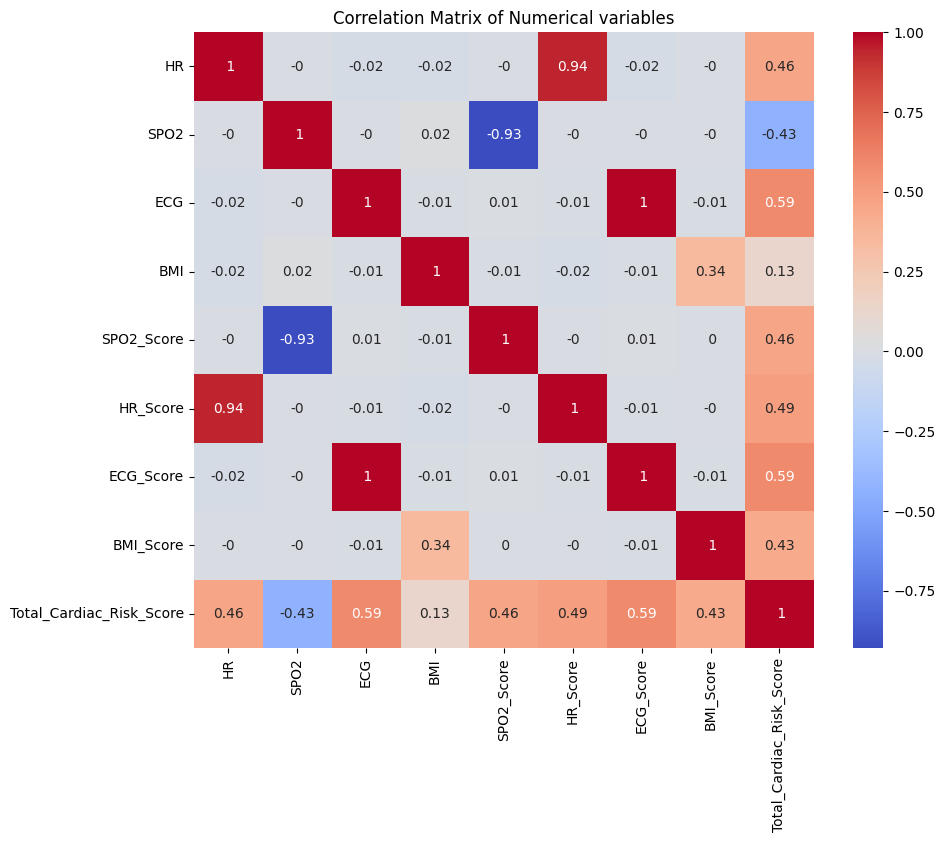

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

#selecting the columns with only numerical values
numerical_columns = working.select_dtypes(include=['int64', 'float64']).columns
# Calculating correlation matrix
correlation_matrix = working[numerical_columns].corr()
correlation_matrix = correlation_matrix.round(2)

# Plotting the correlation matrix using a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt ='2g')
plt.title('Correlation Matrix of Numerical variables')
plt.show()

PEARSON CO-EFFICIENT

In [ ]:
df=pd.read_excel("updated_risk_data.xlsx", engine='openpyxl')
columns=['SPO2_Score','HR_Score','ECG_Score','BMI_Score', 'Total_Cardiac_Risk_Score']
df=df[columns]
selected_datat=df[columns]
pearson_corr=selected_datat.corr(method='pearson')
print("Pearson Correlation Coefficients")
print(pearson_corr)

Pearson Correlation Coefficients
                          SPO2_Score  HR_Score  ECG_Score  BMI_Score  \
SPO2_Score                  1.000000 -0.002038   0.006191   0.002761   
HR_Score                   -0.002038  1.000000  -0.011290  -0.002302   
ECG_Score                   0.006191 -0.011290   1.000000  -0.009182   
BMI_Score                   0.002761 -0.002302  -0.009182   1.000000   
Total_Cardiac_Risk_Score    0.464238  0.492904   0.586174   0.434885   

                          Total_Cardiac_Risk_Score  
SPO2_Score                                0.464238  
HR_Score                                  0.492904  
ECG_Score                                 0.586174  
BMI_Score                                 0.434885  
Total_Cardiac_Risk_Score                  1.000000  


Heatmap of correlation matrix

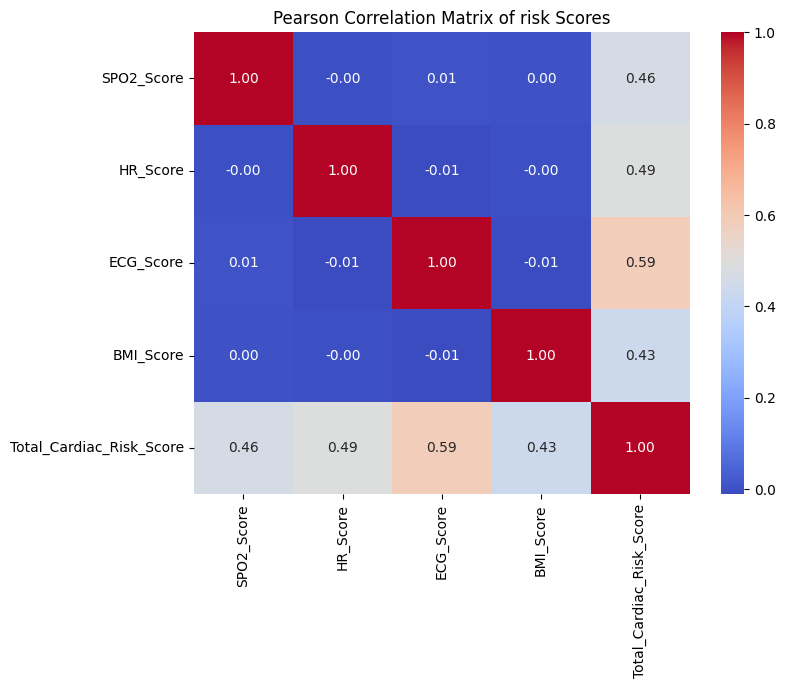

In [ ]:
plt.figure(figsize=(8, 6))
sns.heatmap(pearson_corr, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Pearson Correlation Matrix of risk Scores')
plt.show()

Interpretation of Heatmap

Pearson Correlation Coefficients
                          SPO2_Score  HR_Score  ECG_Score  BMI_Score  \
SPO2_Score                  1.000000 -0.002038   0.006191   0.002761   
HR_Score                   -0.002038  1.000000  -0.011290  -0.002302   
ECG_Score                   0.006191 -0.011290   1.000000  -0.009182   
BMI_Score                   0.002761 -0.002302  -0.009182   1.000000   
Total_Cardiac_Risk_Score    0.464238  0.492904   0.586174   0.434885   

                          Total_Cardiac_Risk_Score  
SPO2_Score                                0.464238  
HR_Score                                  0.492904  
ECG_Score                                 0.586174  
BMI_Score                                 0.434885  
Total_Cardiac_Risk_Score                  1.000000  

OUTLIER DETECTION - using boxplot and zscore

In [ ]:
import scipy.stats

from scipy.stats import zscore

In [ ]:
df=pd.read_excel("updated_risk_data.xlsx", engine='openpyxl')
numerical_columns = df.select_dtypes(include=['int64', 'float64']).columns
numerical_data = df[numerical_columns]



CALCULATING THE Z-SCORES

In [ ]:
calculated_z_score = numerical_data.apply(zscore)

Identify the outliers where z-score >3< -3

In [ ]:
outliers = (calculated_z_score< -3) | (calculated_z_score > 3)

counting the outliers in each column

In [ ]:
outlier_counts = outliers.sum()
print("Number of outliers in each numerical column:")
print(outlier_counts)

Number of outliers in each numerical column:
HR                          0
SPO2                        0
ECG                         0
BMI                         4
SPO2_Score                  0
HR_Score                    0
ECG_Score                   0
BMI_Score                   0
Total_Cardiac_Risk_Score    0
dtype: int64


Visualising the outliers using the boxplots

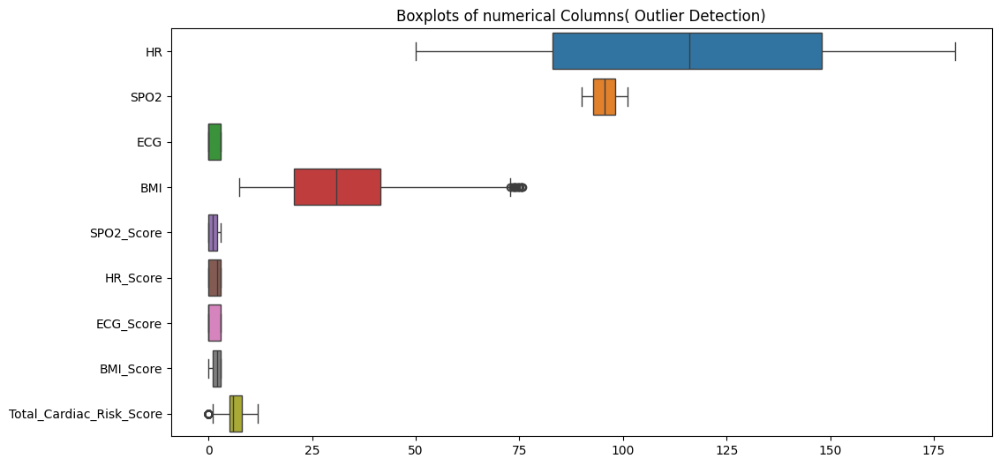

In [ ]:
plt.figure(figsize=(12, 6))
sns.boxplot(data=df, orient='h')
plt.title('Boxplots of numerical Columns( Outlier Detection)')
plt.show()

This shows that the BMI column has outliers. To show the outliers we:

In [ ]:
df=pd.read_excel("/content/updated_risk_data.xlsx", engine='openpyxl')
bmi_zscores=zscore(df['BMI'])
bmi_outliers=df[np.abs(bmi_zscores)>3]
print(bmi_outliers)

      User_ID   HR       SPO2  ECG        BMI  SPO2_Score SPO2_Risk  HR_Score  \
572   U_00573  170  98.636344    0  75.809450           0    Normal         3   
5190  U_05191   96  99.375046    3  75.583736           0    Normal         1   
7439  U_07440   77  94.217075    3  75.655275           1    ⚠️;Low         0   
7784  U_07785  110  93.348260    0  75.490553           2  🔶;Medium         1   

     HR_Risk  ECG_Score ECG_Risk  BMI_Score BMI_Risk  Total_Cardiac_Risk_Score  
572   🆘;High          0   Normal          3   🔴;High                         6  
5190  ⚠️Mild          3   🔴;High          3   🔴;High                         7  
7439  Normal          3   🔴;High          3   🔴;High                         7  
7784  ⚠️Mild          0   Normal          3   🔴;High                         6  


These show the persons with BMI > 3 SD in the dataset. As this is medical data, We will leave the information within the dataset as the numbers are small 4 out of a cohort of 10000, which is statistically insignificant to change the outcome.

In [ ]:
working.isnull().sum()

,0
User_ID,0
HR,0
SPO2,0
ECG,0
BMI,0
SPO2_Score,0
SPO2_Risk,0
HR_Score,0
HR_Risk,0
ECG_Score,0


CATEGORICAL DATA TRANSFORMATION - ONE HOT ENCODING

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import MinMaxScaler

#we start the one hot encoder
encoder = OneHotEncoder(sparse_output=False)

#This is then followed by fit and transform the categorical columns
categorical_columns=numerical_columns = [col for col in df.select_dtypes(include=['object']).columns if col != 'User_ID']
encoded_data = encoder.fit_transform(working[categorical_columns])

#Convert the array into a dataframe with the names
encoded_df = pd.DataFrame(encoded_data, columns=encoder.get_feature_names_out(categorical_columns))
encoded_df.head()
encoded_df

,SPO2_Risk_ ⚠️;Low,SPO2_Risk_! ISOLATED ABNORMALITY❗ → ⚠️;Low,SPO2_Risk_! ISOLATED ABNORMALITY❗ →🔴;High,SPO2_Risk_! ISOLATED ABNORMALITY❗ →🔶;Medium,SPO2_Risk_Normal,SPO2_Risk_🔴;High,SPO2_Risk_🔶;Medium,HR_Risk_! ISOLATED ABNORMALITY❗ →⚠️;Low,HR_Risk_! ISOLATED ABNORMALITY❗ →⚠️Mild,HR_Risk_! ISOLATED ABNORMALITY❗ →🆘;High,...,ECG_Risk_! ISOLATED ABNORMALITY❗ →🔴;High,ECG_Risk_Normal,ECG_Risk_🔴;High,BMI_Risk_! ISOLATED ABNORMALITY❗ →⚠️;Low,BMI_Risk_! ISOLATED ABNORMALITY❗ →🔴;High,BMI_Risk_! ISOLATED ABNORMALITY❗ →🔶;Medium,BMI_Risk_Normal,BMI_Risk_⚠️;Low,BMI_Risk_🔴;High,BMI_Risk_🔶;Medium
0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,...,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
5,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
6,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
7,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
8,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
9,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


 WE WILL CREATE A NEW NAME FOR THE FINAL DATASET. tHIS WILL COMBINE THE ENCODED DATA FRAME WITH THE NUMERICAL DATA FRAME TO CREATE A FINAL DATA FRANE.

In [ ]:
#Getting the numerical columns
numerical_columns= working.select_dtypes(exclude=['object', 'category']).columns


# Commbining the imputed numerical data frame and the encoded categorical data into a new dataframe
final_df = pd.concat([working[numerical_columns], encoded_df], axis=1)
final_df.head()

,HR,SPO2,ECG,BMI,SPO2_Score,HR_Score,ECG_Score,BMI_Score,Total_Cardiac_Risk_Score,SPO2_Risk_ ⚠️;Low,...,ECG_Risk_! ISOLATED ABNORMALITY❗ →🔴;High,ECG_Risk_Normal,ECG_Risk_🔴;High,BMI_Risk_! ISOLATED ABNORMALITY❗ →⚠️;Low,BMI_Risk_! ISOLATED ABNORMALITY❗ →🔴;High,BMI_Risk_! ISOLATED ABNORMALITY❗ →🔶;Medium,BMI_Risk_Normal,BMI_Risk_⚠️;Low,BMI_Risk_🔴;High,BMI_Risk_🔶;Medium
0,147,90.658505,3,27.824009,3,3,3,1,10,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,147,97.133360,0,21.610606,0,3,0,0,3,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
2,176,99.555594,3,16.054269,0,3,3,3,9,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,157,91.444900,0,52.501016,3,3,0,3,9,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,86,96.092103,0,37.317729,0,0,0,2,2,0.0,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


NORMALISATION

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import MinMaxScaler



# Normalization using MinMaxScaler for all columns
scaler = MinMaxScaler()
final_df[final_df.columns] = scaler.fit_transform(final_df[final_df.columns])

# Display and statistics
final_df.head()
num_stats = final_df.describe()
print(num_stats)

                 HR          SPO2          ECG           BMI    SPO2_Score  \
count  10000.000000  10000.000000  10000.00000  10000.000000  10000.000000   
mean       0.504012      0.498373      0.49780      0.359839      0.364333   
std        0.290809      0.288603      0.50002      0.210011      0.388170   
min        0.000000      0.000000      0.00000      0.000000      0.000000   
25%        0.253846      0.247191      0.00000      0.190487      0.000000   
50%        0.507692      0.498555      0.00000      0.341118      0.333333   
75%        0.753846      0.745552      1.00000      0.496397      0.666667   
max        1.000000      1.000000      1.00000      1.000000      1.000000   

           HR_Score    ECG_Score     BMI_Score  Total_Cardiac_Risk_Score  \
count  10000.000000  10000.00000  10000.000000              10000.000000   
mean       0.543767      0.49780      0.680000                  0.521475   
std        0.422890      0.50002      0.371173                  0.210

In [ ]:
print(list(final_df.columns))

['HR', 'SPO2', 'ECG', 'BMI', 'SPO2_Score', 'HR_Score', 'ECG_Score', 'BMI_Score', 'Total_Cardiac_Risk_Score', 'SPO2_Risk_ ⚠️;Low', 'SPO2_Risk_! ISOLATED ABNORMALITY❗ → ⚠️;Low', 'SPO2_Risk_! ISOLATED ABNORMALITY❗ →🔴;High', 'SPO2_Risk_! ISOLATED ABNORMALITY❗ →🔶;Medium', 'SPO2_Risk_Normal', 'SPO2_Risk_🔴;High', 'SPO2_Risk_🔶;Medium', 'HR_Risk_! ISOLATED ABNORMALITY❗ →⚠️;Low', 'HR_Risk_! ISOLATED ABNORMALITY❗ →⚠️Mild', 'HR_Risk_! ISOLATED ABNORMALITY❗ →🆘;High', 'HR_Risk_! ISOLATED ABNORMALITY❗ →🔶;Medium', 'HR_Risk_Normal', 'HR_Risk_⚠️;Low', 'HR_Risk_⚠️Mild', 'HR_Risk_🆘;High', 'HR_Risk_🔶;Medium', 'ECG_Risk_! ISOLATED ABNORMALITY❗ →🔴;High', 'ECG_Risk_Normal', 'ECG_Risk_🔴;High', 'BMI_Risk_! ISOLATED ABNORMALITY❗ →⚠️;Low', 'BMI_Risk_! ISOLATED ABNORMALITY❗ →🔴;High', 'BMI_Risk_! ISOLATED ABNORMALITY❗ →🔶;Medium', 'BMI_Risk_Normal', 'BMI_Risk_⚠️;Low', 'BMI_Risk_🔴;High', 'BMI_Risk_🔶;Medium']


SECTION 3 FEATURE SELECTION

In [ ]:
#  the resultant data now has multi class targed.
#Feature Selection using RandomForestClassifier for multi-class target
# are the target columns in 'final_df'

# we will combine the multi columns into a single target  I will drop the target variable which is the Total Cardiac risk score

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import SelectFromModel

columns_to_combine = ['HR', 'SPO2', 'ECG', 'BMI', 'SPO2_Score', 'HR_Score', 'ECG_Score', 'BMI_Score', 'SPO2_Risk_ ⚠️;Low',
                                                 'SPO2_Risk_! ISOLATED ABNORMALITY❗ → ⚠️;Low', 'SPO2_Risk_! ISOLATED ABNORMALITY❗ →🔴;High',
                                                 'SPO2_Risk_! ISOLATED ABNORMALITY❗ →🔶;Medium', 'SPO2_Risk_Normal', 'SPO2_Risk_🔴;High',
                                                 'SPO2_Risk_🔶;Medium', 'HR_Risk_! ISOLATED ABNORMALITY❗ →⚠️;Low',
                                                 'HR_Risk_! ISOLATED ABNORMALITY❗ →⚠️Mild', 'HR_Risk_! ISOLATED ABNORMALITY❗ →🆘;High', 'HR_Risk_! ISOLATED ABNORMALITY❗ →🔶;Medium',
                                                 'HR_Risk_Normal', 'HR_Risk_⚠️;Low', 'HR_Risk_⚠️Mild', 'HR_Risk_🆘;High', 'HR_Risk_🔶;Medium',
                                                 'ECG_Risk_! ISOLATED ABNORMALITY❗ →🔴;High', 'ECG_Risk_Normal', 'ECG_Risk_🔴;High', 'BMI_Risk_! ISOLATED ABNORMALITY❗ →⚠️;Low',
                                                 'BMI_Risk_! ISOLATED ABNORMALITY❗ →🔴;High', 'BMI_Risk_! ISOLATED ABNORMALITY❗ →🔶;Medium', 'BMI_Risk_Normal', 'BMI_Risk_⚠️;Low',
                                                 'BMI_Risk_🔴;High', 'BMI_Risk_🔶;Medium']
final_df['Total_Cardiac_Risk_Score'] = final_df[columns_to_combine].idxmax(axis=1)


target_variable = 'Total_Cardiac_Risk_Score'

# Split data into  a 20:80 split training and testing sets
X = final_df.drop(columns=[target_variable])
y = final_df[target_variable]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


# Keep a copy of the original X_train with feature names
X_train_original = X_train.copy()

# we will create and train the RandomForestClassifier
rf_classifier = RandomForestClassifier(random_state=42)
rf_classifier.fit(X_train, y_train)

# Feature selection using SelectFromModel
selector = SelectFromModel(rf_classifier, prefit=False, threshold='median')
selector.fit(X_train, y_train)
X_train_selected = selector.transform(X_train)
X_test_selected = selector.transform(X_test)
selected_features = X_train.columns[selector.get_support()]
print("Selected Features:", selected_features)

Selected Features: Index(['HR', 'SPO2', 'ECG', 'BMI', 'SPO2_Score', 'HR_Score', 'ECG_Score',
       'BMI_Score', 'SPO2_Risk_ ⚠️;Low', 'SPO2_Risk_Normal',
       'SPO2_Risk_🔴;High', 'SPO2_Risk_🔶;Medium', 'HR_Risk_🆘;High',
       'ECG_Risk_Normal', 'ECG_Risk_🔴;High',
       'BMI_Risk_! ISOLATED ABNORMALITY❗ →🔴;High', 'BMI_Risk_🔴;High'],
      dtype='object')


**2. Creating and Training the random forest classifier.**

In [ ]:
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix


# we will create and train the RandomForestClassifier
rf_classifier = RandomForestClassifier(random_state=42)
rf_classifier.fit(X_train, y_train)

## Make predictions on the test set
y_pred = rf_classifier.predict(X_test)

# MODEL EVALUATION
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)
print(classification_report(y_test, y_pred))

# FEATURE IMPORTANCE
feature_importances = rf_classifier.feature_importances_

# FEATURE IMPORTANCE DATA FRAME
feature_importance_df = pd.DataFrame({'Feature': X_train.columns, 'Importance': feature_importances})
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Top features
top_5_features = feature_importance_df['Feature'][:10].tolist()

# CNEW DATAFRAME WITH TOP 10 FEATURES
final_df_selected = final_df[[target_variable] + top_5_features]

# Print selected features
print("Selected Features (RandomForestClassifier):", top_5_features)

# Print feature importances
print("Feature Importances:\n", feature_importance_df)

# 8. Display the confusion matrix
cm = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:")
print(cm)

# Get selected feature names using get_feature_names_out
selected_feature_indices = selector.get_support
import joblib
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split


# Save model
joblib.dump(rf_classifier, "cardiac_risk_model.pkl")

# Later, load model
model = joblib.load("cardiac_risk_model.pkl")

# Predict example
sample = X_test.iloc[0].values.reshape(1, -1)
print("Prediction:", model.predict(sample))


Accuracy: 0.9995
                                             precision    recall  f1-score   support

                                  BMI_Score       1.00      1.00      1.00       242
                                        ECG       1.00      1.00      1.00       984
                                         HR       1.00      0.94      0.97        16
                                   HR_Score       1.00      1.00      1.00       304
                          SPO2_Risk_ ⚠️;Low       1.00      1.00      1.00        60
 SPO2_Risk_! ISOLATED ABNORMALITY❗ → ⚠️;Low       1.00      1.00      1.00         2
SPO2_Risk_! ISOLATED ABNORMALITY❗ →🔶;Medium       1.00      1.00      1.00         6
                           SPO2_Risk_Normal       1.00      1.00      1.00       155
                         SPO2_Risk_🔶;Medium       1.00      1.00      1.00        54
                                 SPO2_Score       1.00      1.00      1.00       177

                                   accuracy   

/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


Hyperparameter Tuning

In [ ]:
from google.colab import files

wearable_code = """
[/content/wearable_monitor.py]
"""

with open('wearable_monitor.py', 'w') as f:
    f.write(wearable_code)

files.download('wearable_monitor.py')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
import pandas as pd
import time
from collections import deque
import random  # For simulation purposes

# Model From code
def calculate_risk(row):
    results = {
        'SPO2': {'value': row['SPO2'], 'score': 0, 'risk': 'Normal', 'highlight': ''},
        'HR': {'value': row['HR'], 'score': 0, 'risk': 'Normal', 'highlight': ''},
        'ECG': {'value': row['ECG'], 'score': 0, 'risk': 'Normal', 'highlight': ''},
        'BMI': {'value': row['BMI'], 'score': 0, 'risk': 'Normal', 'highlight': ''}
    }

    spo2 = row['SPO2']
    hr = row['HR']
    ecg = row['ECG']
    Bmi = row['BMI']

    # SPO2 Score calculation
    if spo2 >= 96:
        pass
    elif spo2 >= 94:
        results['SPO2'].update({'score': 1, 'risk': 'Low', 'highlight': '⚠️'})
    elif spo2 >= 92:
        results['SPO2'].update({'score': 2, 'risk': 'Medium', 'highlight': '🔶'})
    else:
        results['SPO2'].update({'score': 3, 'risk': 'High', 'highlight': '🔴'})

    # Heart Rate Score calculation
    if hr <= 40:
        results['HR'].update({'score': 3, 'risk': 'High', 'highlight': '🆘'})
    elif hr <= 50:
        results['HR'].update({'score': 1, 'risk': 'Low', 'highlight': '⚠️'})
    elif hr <= 90:
        pass
    elif hr <= 110:
        results['HR'].update({'score': 1, 'risk': 'Mild', 'highlight': '⚠️'})
    elif hr <= 130:
        results['HR'].update({'score': 2, 'risk': 'Medium', 'highlight': '🔶'})
    else:
        results['HR'].update({'score': 3, 'risk': 'High', 'highlight': '🆘'})

    # ECG Score calculation
    if ecg == 3:
        results['ECG'].update({'score': 3, 'risk': 'High', 'highlight': '🔴'})

    # BMI Score Calculation (Note: BMI typically doesn't change rapidly)
    if Bmi < 18.5:
        results['BMI'].update({'score': 3, 'risk': 'High', 'highlight': '🔴'})
    elif Bmi < 25:
        pass
    elif Bmi < 30:
        results['BMI'].update({'score': 1, 'risk': 'Low', 'highlight': '⚠️'})
    elif Bmi < 40:
        results['BMI'].update({'score': 2, 'risk': 'Medium', 'highlight': '🔶'})
    else:
        results['BMI'].update({'score': 3, 'risk': 'High', 'highlight': '🔴'})

    total_score = sum(results[p]['score'] for p in results)

    # Abnormal parameters identification
    abnormal_params = [p for p in results if results[p]['score'] > 0]
    if len(abnormal_params) == 1:
        param = abnormal_params[0]
        results[param]['highlight'] = '❗' + results[param]['highlight']

    return_data = {
        'timestamp': pd.Timestamp.now(),
        'SPO2_value': results['SPO2']['value'],
        'HR_value': results['HR']['value'],
        'ECG_value': results['ECG']['value'],
        'SPO2_risk': results['SPO2']['highlight'] + results['SPO2']['risk'],
        'HR_risk': results['HR']['highlight'] + results['HR']['risk'],
        'ECG_risk': results['ECG']['highlight'] + results['ECG']['risk'],
        'Total_risk': total_score,
        'Risk_level': get_risk_level(total_score)
    }

    return return_data

def get_risk_level(score):
    if score == 0:
        return "🟢 Normal"
    elif score <= 2:
        return "🟡 Low Risk"
    elif score <= 5:
        return "🟠 Medium Risk"
    else:
        return "🔴 High Risk"

# ====================== Wearable Device Simulator ======================
class WearableMonitor:
    def __init__(self, history_size=10):
        self.history = deque(maxlen=history_size)
        self.bmi = 25.0  # Assuming constant BMI for demo

    def generate_sensor_data(self):
        """Simulates sensor data for demo purposes"""
        return {
            'SPO2': random.uniform(90, 100),  # Oxygen saturation (%)
            'HR': random.randint(40, 180),     # Heart rate (bpm)
            'ECG': random.choice([0, 0, 0, 3]) # ECG status (0=normal, 3=abnormal)
        }

    def get_patient_data(self, simulated=True):
        """Get data either from simulated sensors or real input"""
        if simulated:
            data = self.generate_sensor_data()
        else:
            print("\nEnter patient vitals:")
            data = {
                'SPO2': float(input("SPO2 (%): ")),
                'HR': int(input("Heart Rate (bpm): ")),
                'ECG': int(input("ECG (0=normal, 3=abnormal): "))
            }
        data['BMI'] = self.bmi
        return data

    def update_monitor(self, simulated=True):
        """Process new data and update history"""
        patient_data = self.get_patient_data(simulated)
        risk_assessment = calculate_risk(patient_data)
        self.history.append(risk_assessment)
        return risk_assessment

    def display_history(self):
        """Show the last 10 readings in a table"""
        if not self.history:
            print("No history available yet.")
            return

        print("\n📋 Last 10 Readings:")
        print(f"{'Time':<20} | {'SPO2':<10} | {'HR':<6} | {'ECG':<6} | {'Total Risk':<12} | {'Status':<15}")
        print("-" * 80)
        for reading in self.history:
            print(f"{reading['timestamp'].strftime('%H:%M:%S'):<20} | "
                  f"{reading['SPO2_value']:<10.1f} | "
                  f"{reading['HR_value']:<6} | "
                  f"{'Abnormal' if reading['ECG_value'] == 3 else 'Normal':<6} | "
                  f"{reading['Total_risk']:<12} | "
                  f"{reading['Risk_level']:<15}")

# ====================== Main Application ======================
def main():
    monitor = WearableMonitor()

    print("""
    **************************************
    * WEARABLE CARDIAC RISK MONITOR      *
    * Continuous Health Assessment System*
    **************************************
    """)

    try:
        while True:
            # Get new reading (simulated every 3 seconds)
            latest = monitor.update_monitor(simulated=True)

            # Clear console and display current status
            print("\033[H\033[J")  # Clear console
            print("=== CURRENT STATUS ===")
            print(f"🕒 Last reading: {latest['timestamp'].strftime('%H:%M:%S')}")
            print(f"💓 Heart Rate: {latest['HR_value']} bpm ({latest['HR_risk']})")
            print(f"🫁 SPO2: {latest['SPO2_value']}% ({latest['SPO2_risk']})")
            print(f"📈 ECG: {'Abnormal' if latest['ECG_value'] == 3 else 'Normal'} ({latest['ECG_risk']})")
            print(f"\n🔥 TOTAL RISK SCORE: {latest['Total_risk']} - {latest['Risk_level']}")

            # Visual risk indicator
            risk_bar = "=" * min(latest['Total_risk'] * 2, 20)
            print(f"\n[ {risk_bar:<20} ]")

            # Show history
            monitor.display_history()

            # Alert if high risk
            if latest['Total_risk'] >= 6:
                print("\n🚨 ALERT: HIGH RISK DETECTED! CONSIDER MEDICAL ATTENTION!")

            print("\nPress Ctrl+C to exit...")
            time.sleep(3)  # Wait 3 seconds between readings

    except KeyboardInterrupt:
        print("\nMonitoring stopped.")

if __name__ == "__main__":
    main()


    **************************************
    * WEARABLE CARDIAC RISK MONITOR      *
    * Continuous Health Assessment System*
    **************************************
    

=== CURRENT STATUS ===
🕒 Last reading: 03:08:06
💓 Heart Rate: 42 bpm (⚠️Low)
🫁 SPO2: 96.15864858160262% (Normal)
📈 ECG: Abnormal (🔴High)

🔥 TOTAL RISK SCORE: 5 - 🟠 Medium Risk

[ ==========           ]

📋 Last 10 Readings:
Time                 | SPO2       | HR     | ECG    | Total Risk   | Status         
--------------------------------------------------------------------------------
03:08:06             | 96.2       | 42     | Abnormal | 5            | 🟠 Medium Risk  

Press Ctrl+C to exit...

=== CURRENT STATUS ===
🕒 Last reading: 03:08:09
💓 Heart Rate: 56 bpm (Normal)
🫁 SPO2: 90.14363094829156% (🔴High)
📈 ECG: Normal (Normal)

🔥 TOTAL RISK SCORE: 4 - 🟠 Medium Risk

[ ========             ]

📋 Last 10 Readings:
Time                 | SPO2       | HR     | ECG    | Total Risk   | Status         
------------

In [ ]:
from google.colab import files

wearable_code = """
def calculate_risk(row):
    results = {
        'SPO2': {'value': row['SPO2'], 'score': 0, 'risk': 'Normal', 'highlight': ''},
        'HR': {'value': row['HR'], 'score': 0, 'risk': 'Normal', 'highlight': ''},
        'ECG': {'value': row['ECG'], 'score': 0, 'risk': 'Normal', 'highlight': ''},
        'BMI': {'value': row['BMI'], 'score': 0, 'risk': 'Normal', 'highlight': ''}
    }

    spo2 = row['SPO2']
    hr = row['HR']
    ecg = row['ECG']
    Bmi = row['BMI']

    # SPO2 Score calculation
    if spo2 >= 96:
        pass
    elif spo2 >= 94:
        results['SPO2'].update({'score': 1, 'risk': 'Low', 'highlight': '⚠️'})
    elif spo2 >= 92:
        results['SPO2'].update({'score': 2, 'risk': 'Medium', 'highlight': '🔶'})
    else:
        results['SPO2'].update({'score': 3, 'risk': 'High', 'highlight': '🔴'})

    # Heart Rate Score calculation
    if hr <= 40:
        results['HR'].update({'score': 3, 'risk': 'High', 'highlight': '🆘'})
    elif hr <= 50:
        results['HR'].update({'score': 1, 'risk': 'Low', 'highlight': '⚠️'})
    elif hr <= 90:
        pass
    elif hr <= 110:
        results['HR'].update({'score': 1, 'risk': 'Mild', 'highlight': '⚠️'})
    elif hr <= 130:
        results['HR'].update({'score': 2, 'risk': 'Medium', 'highlight': '🔶'})
    else:
        results['HR'].update({'score': 3, 'risk': 'High', 'highlight': '🆘'})

    # ECG Score calculation
    if ecg == 3:
        results['ECG'].update({'score': 3, 'risk': 'High', 'highlight': '🔴'})

    # BMI Score Calculation (Note: BMI typically doesn't change rapidly)
    if Bmi < 18.5:
        results['BMI'].update({'score': 3, 'risk': 'High', 'highlight': '🔴'})
    elif Bmi < 25:
        pass
    elif Bmi < 30:
        results['BMI'].update({'score': 1, 'risk': 'Low', 'highlight': '⚠️'})
    elif Bmi < 40:
        results['BMI'].update({'score': 2, 'risk': 'Medium', 'highlight': '🔶'})
    else:
        results['BMI'].update({'score': 3, 'risk': 'High', 'highlight': '🔴'})

    total_score = sum(results[p]['score'] for p in results)

    # Abnormal parameters identification
    abnormal_params = [p for p in results if results[p]['score'] > 0]
    if len(abnormal_params) == 1:
        param = abnormal_params[0]
        results[param]['highlight'] = '❗' + results[param]['highlight']

    return_data = {
        'timestamp': pd.Timestamp.now(),
        'SPO2_value': results['SPO2']['value'],
        'HR_value': results['HR']['value'],
        'ECG_value': results['ECG']['value'],
        'SPO2_risk': results['SPO2']['highlight'] + results['SPO2']['risk'],
        'HR_risk': results['HR']['highlight'] + results['HR']['risk'],
        'ECG_risk': results['ECG']['highlight'] + results['ECG']['risk'],
        'Total_risk': total_score,
        'Risk_level': get_risk_level(total_score)
    }

    return return_data

def get_risk_level(score):
    if score == 0:
        return "🟢 Normal"
    elif score <= 2:
        return "🟡 Low Risk"
    elif score <= 5:
        return "🟠 Medium Risk"
    else:
        return "🔴 High Risk"]
"""

with open('wearable_monitor.py', 'w') as f:
    f.write(wearable_code)

files.download('wearable_monitor.py')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
import pandas as pd
import time
import sqlite3
from datetime import datetime
import random
from collections import deque
import threading

# ====================== Database Setup ======================
def init_db():
    conn = sqlite3.connect('cardiac_monitor.db')
    c = conn.cursor()
    c.execute('''CREATE TABLE IF NOT EXISTS readings
                 (timestamp TEXT, spo2 REAL, hr INTEGER, ecg INTEGER,
                  bmi REAL, total_risk INTEGER, risk_level TEXT)''')
    conn.commit()
    conn.close()

def save_reading(reading):
    required_keys = ['timestamp', 'SPO2_value', 'HR_value', 'ECG_value', 'BMI_value', 'Total_risk', 'Risk_level']
    if not all(key in reading for key in required_keys):
        print("Missing data in reading:", reading)
        return
    conn = sqlite3.connect('cardiac_monitor.db')
    c = conn.cursor()
    c.execute('''INSERT INTO readings VALUES
                 (?,?,?,?,?,?,?)''', (
        reading['timestamp'].isoformat(),
        reading['SPO2_value'],
        reading['HR_value'],
        reading['ECG_value'],
        reading['BMI_value'],
        reading['Total_risk'],
        reading['Risk_level']
    ))
    conn.commit()
    conn.close()

def load_history(limit=10):
    conn = sqlite3.connect('cardiac_monitor.db')
    df = pd.read_sql(f'SELECT * FROM readings ORDER BY timestamp DESC LIMIT {limit}', conn)
    conn.close()
    return df

# ====================== Risk Calculation ======================
def calculate_risk(data):
    results = {
        'SPO2': {'value': data['SPO2'], 'score': 0, 'risk': 'Normal', 'highlight': ''},
        'HR': {'value': data['HR'], 'score': 0, 'risk': 'Normal', 'highlight': ''},
        'ECG': {'value': data['ECG'], 'score': 0, 'risk': 'Normal', 'highlight': ''},
        'BMI': {'value': data['BMI'], 'score': 0, 'risk': 'Normal', 'highlight': ''}
    }

    if data['SPO2'] < 92:
        results['SPO2'].update({'score': 3, 'risk': 'High', 'highlight': '🔴'})
    elif data['SPO2'] < 94:
        results['SPO2'].update({'score': 2, 'risk': 'Medium', 'highlight': '🔶'})
    elif data['SPO2'] < 96:
        results['SPO2'].update({'score': 1, 'risk': 'Low', 'highlight': '⚠️'})

    if data['HR'] > 130 or data['HR'] <= 40:
        results['HR'].update({'score': 3, 'risk': 'High', 'highlight': '🆘'})
    elif data['HR'] > 110 or data['HR'] <= 50:
        results['HR'].update({'score': 2, 'risk': 'Medium', 'highlight': '🔶'})
    elif data['HR'] > 90 or data['HR'] <= 60:
        results['HR'].update({'score': 1, 'risk': 'Mild', 'highlight': '⚠️'})

    if data['ECG'] == 3:
        results['ECG'].update({'score': 3, 'risk': 'High', 'highlight': '🔴'})

    if data['BMI'] >= 40 or data['BMI'] < 18.5:
        results['BMI'].update({'score': 3, 'risk': 'High', 'highlight': '🔴'})
    elif data['BMI'] >= 30:
        results['BMI'].update({'score': 2, 'risk': 'Medium', 'highlight': '🔶'})
    elif data['BMI'] >= 25:
        results['BMI'].update({'score': 1, 'risk': 'Low', 'highlight': '⚠️'})

    total_score = sum(results[p]['score'] for p in results)

    return {
        'timestamp': datetime.now(),
        'SPO2_value': results['SPO2']['value'],
        'HR_value': results['HR']['value'],
        'ECG_value': results['ECG']['value'],
        'BMI_value': results['BMI']['value'],
        'SPO2_risk': results['SPO2']['highlight'] + results['SPO2']['risk'],
        'HR_risk': results['HR']['highlight'] + results['HR']['risk'],
        'ECG_risk': results['ECG']['highlight'] + results['ECG']['risk'],
        'Total_risk': total_score,
        'Risk_level': get_risk_level(total_score)
    }

def get_risk_level(score):
    if score == 0:
        return "🟢 Normal"
    elif score <= 2:
        return "🟡 Low Risk"
    elif score <= 5:
        return "🟠 Medium Risk"
    else:
        return "🔴 High Risk"

# ====================== Wearable Monitor ======================
class WearableMonitor:
    def __init__(self, history_size=10):
        self.history = deque(maxlen=history_size)
        self.bmi = None
        init_db()

    def set_bmi(self):
        while True:
            try:
                self.bmi = float(input("Enter patient's BMI (e.g., 22.5): "))
                if 15 <= self.bmi <= 50:
                    break
                print("BMI should be between 15-50")
            except ValueError:
                print("Please enter a valid number")

    def get_wearable_data(self):
        return {
            'SPO2': 95 + 5 * (0.5 - random.random()),
            'HR': 70 + int(50 * (0.5 - random.random())),
            'ECG': random.choices([0, 1, 3], weights=[0.9, 0.05, 0.05])[0],
            'BMI': self.bmi
        }

    def update_reading(self):
        data = self.get_wearable_data()
        risk_assessment = calculate_risk(data)
        self.history.append(risk_assessment)
        save_reading(risk_assessment)
        return risk_assessment

# ====================== Main Application ======================
def main():
    monitor = WearableMonitor()
    print("""
    **************************************
    * WEARABLE CARDIAC RISK MONITOR      *
    * Real-time Health Assessment System *
    **************************************
    """)
    try:
        print("\nFirst, set the patient's baseline information:")
        monitor.set_bmi()

        while True:
            latest = monitor.update_reading()
            print("\033[H\033[J")  # Clear screen
            print(f"=== LIVE MONITORING (BMI: {monitor.bmi:.1f}) ===")
            print(f"🕒 Last update: {datetime.now().strftime('%H:%M:%S')}")
            print(f"💓 HR: {latest['HR_value']} bpm ({latest['HR_risk']})")
            print(f"🫁 SPO2: {latest['SPO2_value']:.2f}% ({latest['SPO2_risk']})")
            print(f"📈 ECG: {'Abnormal' if latest['ECG_value'] == 3 else 'Normal'}")
            print(f"\n🔥 TOTAL RISK: {latest['Total_risk']} - {latest['Risk_level']}")

            if latest['Total_risk'] >= 6:
                print("\n🚨 ALERT: HIGH RISK DETECTED!")
            elif latest['Total_risk'] >= 3:
                print("\n⚠️ Warning: Moderate Risk")

            print("""
📋 OPTIONS:
[1] View history
[2] Change BMI
[3] Export history
[q] Quit
(Or press Enter to continue monitoring)
""")
            choice = input("Select an option: ").strip().lower()
            if choice == '1':
                history = load_history()
                print("\n📜 Full History:")
                print(history[['timestamp', 'spo2', 'hr', 'ecg', 'total_risk']].to_string(index=False))
                input("\nPress Enter to return to monitoring...")
            elif choice == '2':
                monitor.set_bmi()
            elif choice == '3':
                history = load_history(1000)
                filename = f"cardiac_data_{datetime.now().date()}.csv"
                history.to_csv(filename, index=False)
                print(f"✅ Exported {len(history)} records to {filename}")
                time.sleep(2)
            elif choice == 'q':
                break
            else:
                time.sleep(5)

    except KeyboardInterrupt:
        print("\nMonitoring stopped by user.")
    finally:
        print("\nFinalizing data storage...")
        history = load_history()
        print(f"Stored {len(history)} records in database")

if __name__ == "__main__":
    main()



    **************************************
    * WEARABLE CARDIAC RISK MONITOR      *
    * Real-time Health Assessment System *
    **************************************
    

First, set the patient's baseline information:
Enter patient's BMI (e.g., 22.5): 25

=== LIVE MONITORING (BMI: 25.0) ===
🕒 Last update: 03:08:38
💓 HR: 68 bpm (Normal)
🫁 SPO2: 92.90% (🔶Medium)
📈 ECG: Normal

🔥 TOTAL RISK: 3 - 🟠 Medium Risk

⚠️ Warning: Moderate Risk

📋 OPTIONS:
[1] View history
[2] Change BMI
[3] Export history
[q] Quit
(Or press Enter to continue monitoring)

Select an option: 25

=== LIVE MONITORING (BMI: 25.0) ===
🕒 Last update: 03:08:47
💓 HR: 70 bpm (Normal)
🫁 SPO2: 93.95% (🔶Medium)
📈 ECG: Normal

🔥 TOTAL RISK: 3 - 🟠 Medium Risk

⚠️ Warning: Moderate Risk

📋 OPTIONS:
[1] View history
[2] Change BMI
[3] Export history
[q] Quit
(Or press Enter to continue monitoring)

Select an option: q

Finalizing data storage...
Stored 2 records in database


In [ ]:
!pip install streamlit pyngrok --quiet


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.1/10.1 MB 69.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.9/6.9 MB 84.1 MB/s eta 0:00:00


In [ ]:
%%writefile cardiac_app.py
import streamlit as st
from datetime import datetime
import random
!npm install -g LocalTunnel
import os
os.environ['PATH'] += os.pathsep + os.path.expanduser('~') + '/.local/bin'
import subprocess
import time
import webbrowser
from IPython.display import display, HTML
from google.colab.output import eval_js
public_url = eval_js("google.colab.kernel.proxyPort(8501)")

# ====================== Wearable Monitor ======================
streamlit_port = 8502
streamlit_process = subprocess.Popen(
    ["streamlit", "run", "cardiac_app.py", "--server.port", str(streamlit_port)],
    stdout=subprocess.DEVNULL,
    stderr=subprocess.DEVNULL
st.set_page_config(page_title="Cardiac Risk Monitor", page_icon="❤️")

st.title("💓 Cardiac Risk Monitor (Wearable Prototype)")
st.markdown("Monitor patient's cardiac risk using simulated smart device data.")

# Simulated Input (could be replaced by real wearable input in future)
bmi = st.slider("Patient BMI", 15.0, 45.0, 25.0)
spo2 = st.slider("Blood Oxygen Level (SpO2 %)", 80.0, 100.0, 96.0)
hr = st.slider("Heart Rate (bpm)", 30, 160, 75)
ecg = st.selectbox("ECG Classification", [0, 1, 3], index=0)

def calculate_risk(spo2, hr, ecg, bmi):
    score = 0
    if spo2 < 92: score += 3
    elif spo2 < 94: score += 2
    elif spo2 < 96: score += 1

    if hr > 130 or hr <= 40: score += 3
    elif hr > 110 or hr <= 50: score += 2
    elif hr > 90 or hr <= 60: score += 1

    if ecg == 3: score += 3

    if bmi >= 40 or bmi < 18.5: score += 3
    elif bmi >= 30: score += 2
    elif bmi >= 25: score += 1

    if score == 0:
        return score, "🟢 Normal"
    elif score <= 2:
        return score, "🟡 Low Risk"
    elif score <= 5:
        return score, "🟠 Medium Risk"
    else:
        return score, "🔴 High Risk"

score, level = calculate_risk(spo2, hr, ecg, bmi)

st.markdown(f"### 📊 Risk Score: **{score}**")
st.markdown(f"### 🔥 Risk Level: **{level}**")
st.caption(f"🕒 Assessed at: {datetime.now().strftime('%H:%M:%S')}")

if score >= 6:
    st.error("🚨 High Risk: Immediate medical attention advised.")
elif score >= 3:
    st.warning("⚠️ Moderate Risk: Monitor closely.")
else:
    st.success("✅ Stable condition.")


Writing cardiac_app.py


In [ ]:
# Install LocalTunnel and reload Node.js global tools
!npm install -g localtunnel


⠙⠹⠸⠼⠴⠦⠧⠇⠏⠋⠙⠹⠸⠼⠴⠦⠧⠇⠏⠋⠙⠹⠸⠼⠴⠦⠧⠇⠏⠋⠙⠹⠸⠼⠴⠦⠧⠇⠏⠋⠙
added 22 packages in 5s
⠙
⠙3 packages are looking for funding
⠙  run `npm fund` for details
⠙

In [ ]:
import subprocess
import time
from IPython.display import display, HTML

# Port where your Streamlit app will run
streamlit_port = 8502

# 1. Start the Streamlit app
streamlit_process = subprocess.Popen(
    ["streamlit", "run", "cardiac_app.py", "--server.port", str(streamlit_port)],
    stdout=subprocess.DEVNULL,
    stderr=subprocess.DEVNULL
)

# 2. Wait for app to launch
time.sleep(7)

# 3. Start LocalTunnel
try:
    print("🚀 Launching LocalTunnel...")
    lt_process = subprocess.Popen(
        ["lt", "--port", str(streamlit_port)],
        stdout=subprocess.PIPE,
        stderr=subprocess.STDOUT,  # Merge stderr into stdout
        universal_newlines=True
    )

    # 4. Read LocalTunnel output and look for URL
    public_url = None
    start_time = time.time()

    while time.time() - start_time < 30:  # Wait max 30 seconds
        output_line = lt_process.stdout.readline()
        print(f"LocalTunnel output: {output_line.strip()}")
        if "https://" in output_line:
            public_url = output_line.strip()
            break
        time.sleep(0.5)

    # 5. Show link or error
    if public_url:
        print(f"\n✅ Public URL: {public_url}")
        display(HTML(f'<a href="{public_url}" target="_blank">🔗 Open Streamlit App</a>'))
    else:
        print("❌ Could not retrieve the public URL from LocalTunnel.")
        lt_process.kill()

except FileNotFoundError:
    print("\n❌ Error: 'lt' (LocalTunnel) not found.")
    print("Please run: !npm install -g localtunnel")

except Exception as e:
    print(f"❌ An unexpected error occurred: {e}")

finally:
    if streamlit_process.poll() is None:
      pass
        # streamlit_process.terminate()
        #print("Streamlit process terminated.")
    if 'lt_process' in locals() and lt_process.poll() is None:
      pass
        #lt_process.terminate()
        #print("LocalTunnel process terminated.")


🚀 Launching LocalTunnel...
LocalTunnel output: your url is: https://yummy-grapes-tie.loca.lt

✅ Public URL: your url is: https://yummy-grapes-tie.loca.lt
